# init

In [3]:
from __future__ import print_function, division

import matplotlib.pyplot as plt
#%matplotlib notebook
import math

#3次元プロットするためのモジュール
from mpl_toolkits.mplot3d import Axes3D

# 数値計算やデータフレーム操作に関するライブラリをインポートする
import numpy as np
import pandas as pd

# URL によるリソースへのアクセスを提供するライブラリをインポートする。
import urllib.request 

import sklearn #機械学習のライブラリ
from sklearn.decomposition import PCA #主成分分析器

from matplotlib import animation, rc
from IPython.display import HTML

In [4]:
def logistic(a, x):
  return a*x*(1.0-x)

def next_x(f, L, x):
    x_new = np.empty(x.shape)
    for i in range(L):
        if i == 0:
            x_new[i] = (1 - 2.0*eps) * f(r,x[i]) + eps * (0*f(r,x[L-1]) + f(r,x[i+1]))
        elif i == L - 1:
            x_new[i] = (1 - 2.0*eps) * f(r,x[i]) + eps * (f(r,x[i-1]) + 0*f(r,x[0]))
        elif i > 0 and i < L - 1:
            x_new[i] = (1 - 2.0*eps) * f(r,x[i]) + eps * (f(r,x[i-1]) + f(r,x[i+1]))
    return x_new


# CMLのプログラムを流用したもの。
プロットの実行時間が非常に長い.
左の目次よりセクション指定できる.

参考
https://qiita.com/MuAuan/items/a05a9823345ff75251ff

全てここ参照
https://atatat.hatenablog.com/entry/colab_python8_animation


## cluster

0.08639392643942738


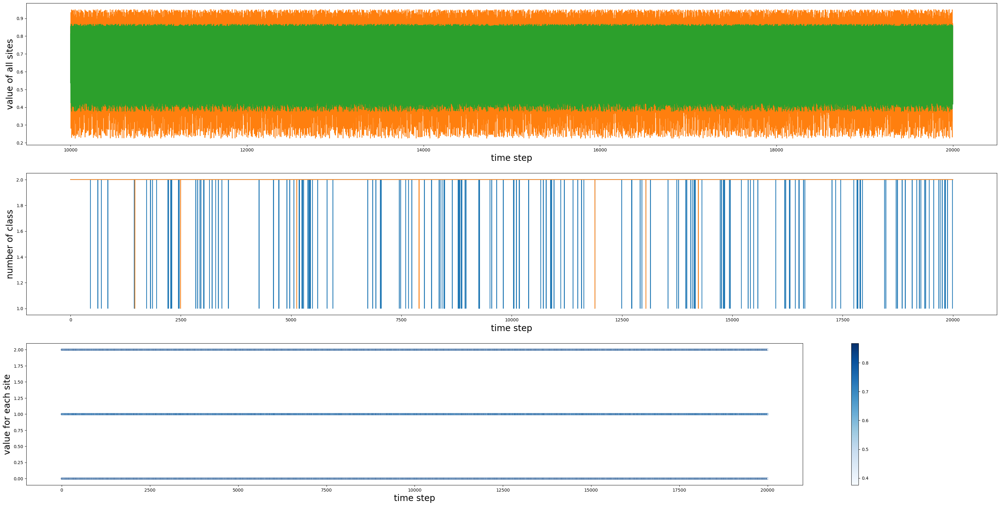

In [5]:
L = 3     # no. of lattice sites
D=0.3
eps = (1.0-math.exp(-D))/3.0   # diffusive coupling strength: 
print(eps)
r = 3.8     # control parameter r:
P1 = float(2**8) # accuracy
P2 = float(2**12)
"""
時刻 n , 精度 P クラスター数 (k_n)^P の表示
ex: 1/P=2^(-18), 2^(-12)
p150参照
"""
np.random.seed(1010)
ic = np.random.uniform(0.1, 0.9, L)  # random initial condition betn. (0,1)

nTransients = 20000   # The iterates we'll throw away
nSteps = 20000       # This sets how many time steps will be described

#縦 site, 横 time(step)
states = np.empty((nSteps, L))

for i in range(nTransients):
  ic=next_x(logistic, L, ic)

states[0]=ic
class_numsP1=[]
class_numsP2=[]
for i in range(nSteps-1):
  states[i+1]=next_x(logistic, L, states[i])
  
  #clusteringP1
  clustering_list = list(map(lambda x: float(int(x*P1))/P1, states[i])) 
  num=len(list(set(clustering_list)) )
  class_numsP1.append(num)

  #clusteringP2
  clustering_list = list(map(lambda x: float(int(x*P2))/P2, states[i])) 
  num=len(list(set(clustering_list)) )
  class_numsP2.append(num)

#最後だけ追加P1
clustering_list = list(map(lambda x: float(int(x*P1))/P1, states[nSteps-1])) 
num=len(list(set(clustering_list)) )
class_numsP1.append(num)

#最後だけ追加P2
clustering_list = list(map(lambda x: float(int(x*P2))/P2, states[nSteps-1])) 
num=len(list(set(clustering_list)) )
class_numsP2.append(num)


plt.rcParams["figure.figsize"] = (40, 20)#(縦, 横)

#図の作成指示
fig=plt.figure()#(figsize=(100,100))
ax1=fig.subplots(3,1)

#１つ目の図
ax1[0].set_xlabel("time step",fontsize=20)
ax1[0].set_ylabel("value of all sites",fontsize=20)  

time=np.arange(20000)
ax1[0].plot(time[-10000:], states[-10000:])

#２つ目の図 p150参照, clustering
ax1[1].set_xlabel("time step", fontsize=20)
ax1[1].set_ylabel("number of class", fontsize=20)
ax1[1].plot(time, class_numsP1)
ax1[1].plot(time, class_numsP2)

#３つ目の図
ax1[2].set_xlabel("time step",fontsize=20)
ax1[2].set_ylabel("value for each site",fontsize=20)  

for i in range(L):
  bar=ax1[2].scatter(time, np.tile(i, time.size), s=8, c=states[:,i], cmap='Blues', marker=",")
fig.colorbar(bar)

# Display plot in window
plt.show() 

## 3d

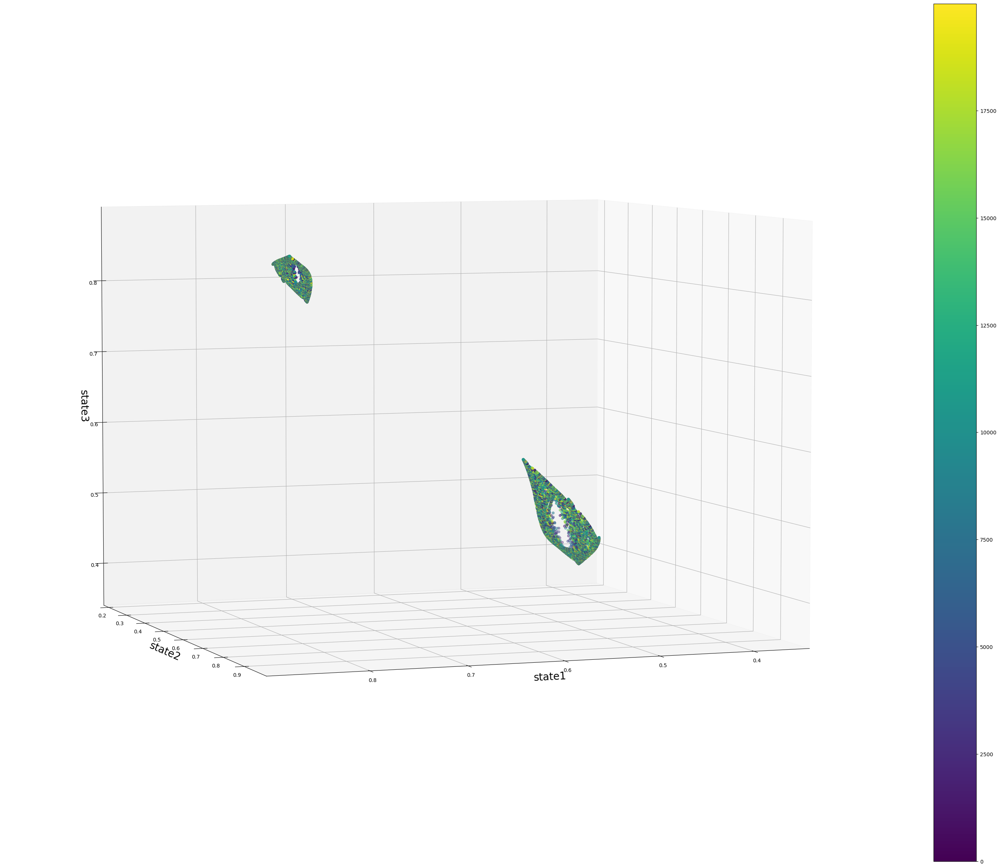

In [6]:
#%matplotlib inline
fig=plt.figure(figsize=(50,30))#(figsize=(100,100))
# ax1 = Axes3D(fig)
ax1=fig.add_subplot(projection='3d')
# 3Dグラフの見る方向の初期値を設定
ax1.view_init(elev=5, azim=70)
#図の設定
ax1.set_xlabel("state1",fontsize=20)
ax1.set_ylabel("state2",fontsize=20)  
ax1.set_zlabel("state3",fontsize=20) 
bar=ax1.scatter3D(states[:, 0], states[:, 1], states[:, 2], c=list(np.arange(len(states[:, 0]))))
fig.colorbar(bar)
plt.show()

## PCA

In [7]:
df=pd.DataFrame(states)
# 行列の標準化
dfs = df.iloc[:, :].apply(lambda x: (x-x.mean())/x.std(), axis=0)
dfs.head()

#主成分分析の実行
pca = PCA()
pca.fit(dfs)
# データを主成分空間に写像
feature = pca.transform(dfs)
print(feature)

[[-1.89747613e+00  1.29618518e-01 -1.42035804e-16]
 [ 2.38714306e+00 -3.73033063e-01  2.04233824e-16]
 [-1.32444645e+00 -2.65532269e-01 -5.91255585e-17]
 ...
 [ 9.72336507e-01  6.59592066e-01  8.32714139e-17]
 [-1.75535402e+00 -1.00682145e-01 -1.09895442e-16]
 [ 1.92779599e+00  1.37404214e-01  1.11578139e-16]]


### 3d

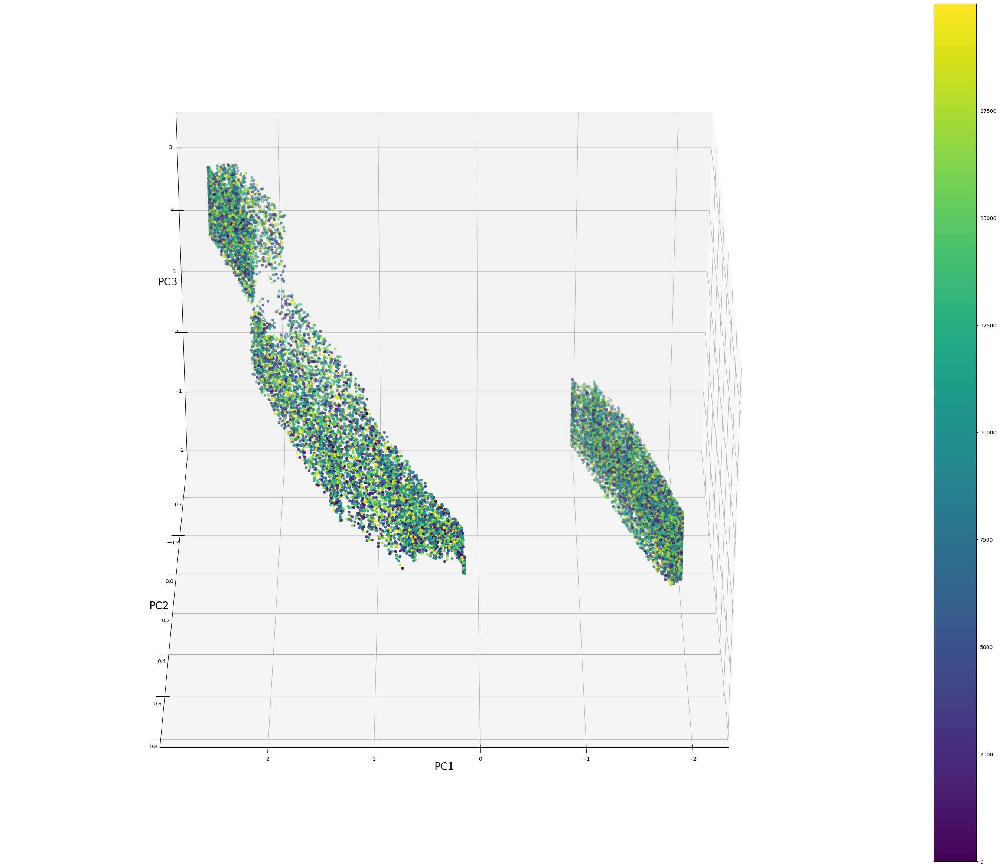

In [8]:
%matplotlib inline
fig=plt.figure(figsize=(50,30))#(figsize=(100,100))
# ax1 = Axes3D(fig)
ax1=fig.add_subplot(projection='3d')
# 3Dグラフの見る方向の初期値を設定
ax1.view_init(elev=30, azim=90)
#図の設定
ax1.set_xlabel("PC1",fontsize=20)
ax1.set_ylabel("PC2",fontsize=20)  
ax1.set_zlabel("PC3",fontsize=20) 
bar=ax1.scatter3D(feature[:, 0], feature[:, 1], feature[:, 2], c=list(np.arange(len(feature[:, 0]))))
fig.colorbar(bar)
plt.show()

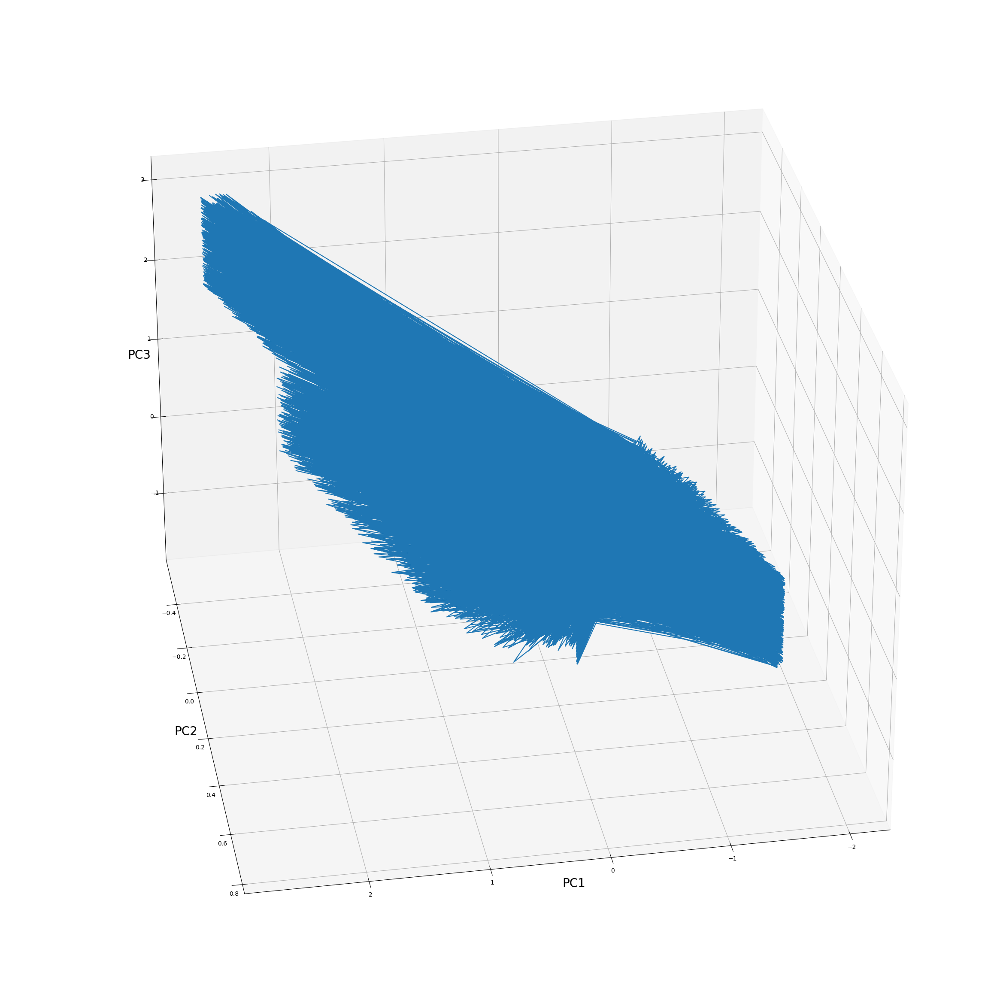

In [9]:
%matplotlib inline
fig=plt.figure(figsize=(50,30))#(figsize=(100,100))
ax1 = fig.add_subplot(111, projection='3d')

# 3Dグラフの見る方向の初期値を設定
ax1.view_init(elev=30, azim=80)

#図の設定
#軸ラベル
ax1.set_xlabel("PC1",fontsize=20)
ax1.set_ylabel("PC2",fontsize=20)  
ax1.set_zlabel("PC3",fontsize=20) 

#軸メモリ: 例
#ax.set_xticks([-1.0, -0.5, 0.0, 0.5, 1.0])
#ax.set_yticks([-1.0, -0.5, 0.0, 0.5, 1.0])

bar=ax1.plot(feature[:10000, 0], feature[:10000, 1], feature[:10000, 2])
#データ数制限 2,0000は無理, 10000はok
#fig.colorbar(bar)
plt.show()

### animation

In [10]:
%matplotlib inline

fig=plt.figure(figsize=(10,4))#(figsize=(100,100))
ax1 = fig.add_subplot(111, projection='3d')

# 3Dグラフの見る方向の初期値を設定
ax1.view_init(elev=10, azim=80)

#図の設定
#軸ラベル
ax1.set_xlabel("PC1",fontsize=20)
ax1.set_ylabel("PC2",fontsize=20)  
ax1.set_zlabel("PC3",fontsize=20) 

def animate(i):
    ax1.view_init(elev=30., azim=3.6*i%360)
    ln=ax1.plot(feature[i*150:(i+1)*150, 0], feature[i*150:(i+1)*150, 1], feature[i*150:(i+1)*150, 2])
    return ln
"""
return ln, 
とするとerror
"""
ani = animation.FuncAnimation(fig, animate, init_func=None,
                               frames=100, interval=100, blit=True)  
plt.close()

# JavascriptウィジェットをアニメーションオブジェクトのデフォルトのHTML表現として設定
rc('animation', html='jshtml')
ani

In [11]:
%matplotlib inline

fig=plt.figure(figsize=(10,4))#(figsize=(100,100))
ax1 = fig.add_subplot(111, projection='3d')

# 3Dグラフの見る方向の初期値を設定
ax1.view_init(elev=10, azim=80)

#図の設定
#軸ラベル
ax1.set_xlabel("PC1",fontsize=20)
ax1.set_ylabel("PC2",fontsize=20)  
ax1.set_zlabel("PC3",fontsize=20) 

def animate(i):
    ax1.view_init(elev=30., azim=3.6*i%360)
    ln=ax1.plot(feature[i*150:(i+1)*150, 0], feature[i*150:(i+1)*150, 1], feature[i*150:(i+1)*150, 2],
                "o", markersize=1)
    return ln
"""
return ln, 
とするとerror
"""
ani = animation.FuncAnimation(fig, animate, init_func=None,
                               frames=100, interval=100, blit=True)  
plt.close()

# JavascriptウィジェットをアニメーションオブジェクトのデフォルトのHTML表現として設定
rc('animation', html='jshtml')
ani

# 以下から簡略化したprogram 2022/09
実行時間が短い.

カオス的遍歴:Dを変えてみたがみられなかった?

固定端にしていたことが原因, 自由端である. 


In [12]:
def next_x(f, L, x):
    x_new = np.empty(x.shape)
    for i in range(L):
        if i == 0:
            x_new[i] = (1 - 2.0*eps) * f(r,x[i]) + eps * (f(r,x[L-1]) + f(r,x[i+1]))
        elif i == L - 1:
            x_new[i] = (1 - 2.0*eps) * f(r,x[i]) + eps * (f(r,x[i-1]) + f(r,x[0]))
        elif i > 0 and i < L - 1:
            x_new[i] = (1 - 2.0*eps) * f(r,x[i]) + eps * (f(r,x[i-1]) + f(r,x[i+1]))
    return x_new
"""
自由端である??
"""

## series

0.08241111843126792


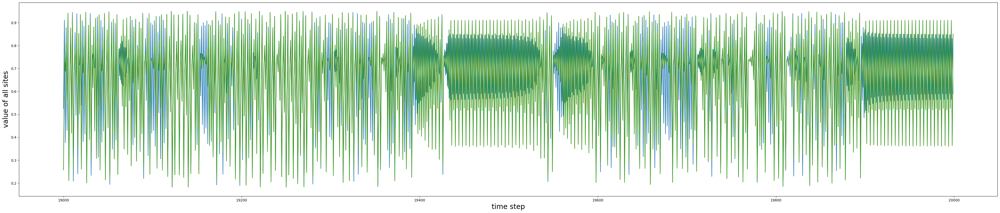

In [13]:
from __future__ import print_function, division

L = 3     # no. of lattice sites
D=0.284
eps = (1.0-math.exp(-D))/3.0   # diffusive coupling strength: 
print(eps)
r = 3.8     # control parameter r:

np.random.seed(1010)
ic = np.random.uniform(0.1, 0.9, L)  # random initial condition betn. (0,1)

nTransients = 20000   # The iterates we'll throw away
nSteps = 20000       # This sets how many time steps will be described


#縦 site, 横 time(step)
states = np.empty((nSteps, L))

for i in range(nTransients):
  ic=next_x(logistic, L, ic)

states[0]=ic

for i in range(nSteps-1):
  states[i+1]=next_x(logistic, L, states[i])

plt.rcParams["figure.figsize"] = (50, 10)#(横, 縦)

#図の作成指示
fig=plt.figure()#(figsize=(100,100))
ax1=fig.subplots(1,1)

#１つ目の図
ax1.set_xlabel("time step",fontsize=20)
ax1.set_ylabel("value of all sites",fontsize=20)  

time=np.arange(20000)
ax1.plot(time[-1000:], states[-1000:])
"""
(1,1)という指定では
ax1[0]
ax1[1]
とかiteratesは不要
"""
# Display plot in window
plt.show() 

## 3d

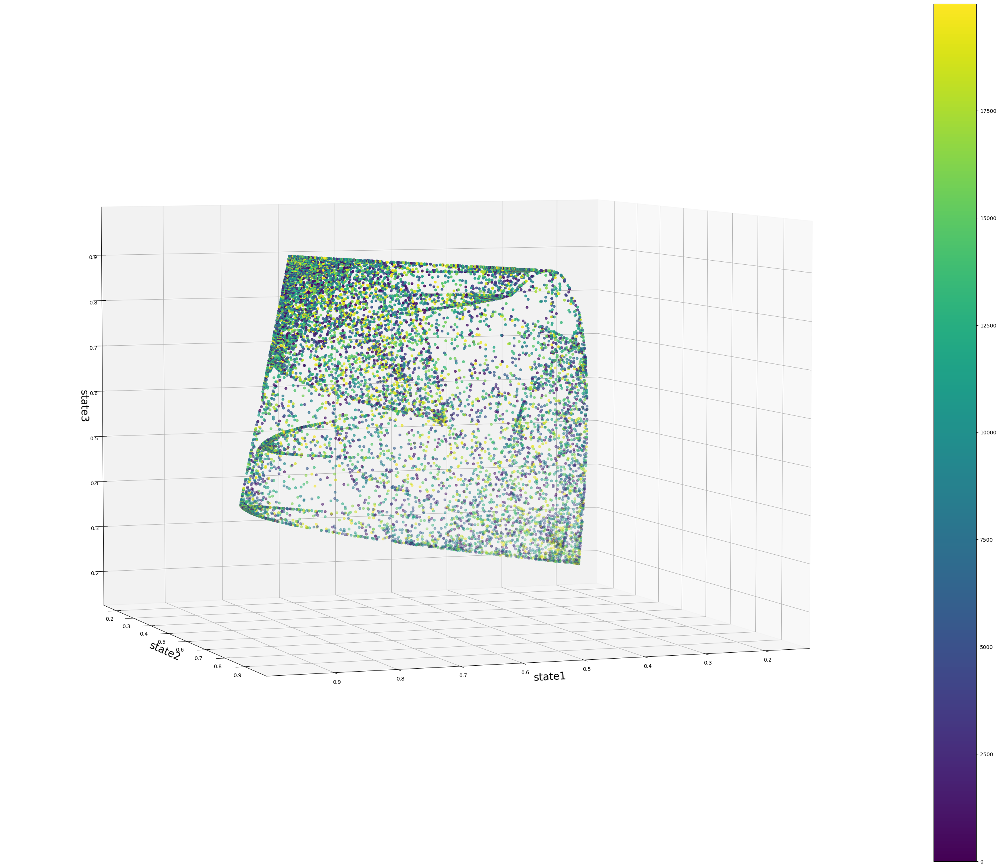

In [14]:
#%matplotlib inline
fig=plt.figure(figsize=(50,30))#(figsize=(100,100))
# ax1 = Axes3D(fig)
ax1=fig.add_subplot(projection='3d')
# 3Dグラフの見る方向の初期値を設定
ax1.view_init(elev=5, azim=70)
#図の設定
ax1.set_xlabel("state1",fontsize=20)
ax1.set_ylabel("state2",fontsize=20)  
ax1.set_zlabel("state3",fontsize=20) 
bar=ax1.scatter3D(states[:, 0], states[:, 1], states[:, 2], c=list(np.arange(len(states[:, 0]))))
fig.colorbar(bar)
plt.show()

## PCA

In [15]:
df=pd.DataFrame(states)
# 行列の標準化
dfs = df.iloc[:, :].apply(lambda x: (x-x.mean())/x.std(), axis=0)
dfs.head()

#主成分分析の実行
pca = PCA()
pca.fit(dfs)
# データを主成分空間に写像
feature = pca.transform(dfs)
print(feature)

[[-1.32886158e+00  1.01870275e+00 -1.30132026e-16]
 [ 1.53585509e+00 -1.25402472e+00  1.12616660e-16]
 [-9.93817145e-01  7.85028706e-01 -1.25635769e-16]
 ...
 [-1.32519946e+00  1.00801233e+00 -1.42812273e-16]
 [ 1.51881560e+00 -1.24819545e+00  1.52193468e-16]
 [-1.01195847e+00  7.85320020e-01 -1.44196711e-16]]


### animation

In [16]:
%matplotlib inline

fig=plt.figure(figsize=(10,4))#(figsize=(100,100))
ax1 = fig.add_subplot(111, projection='3d')

# 3Dグラフの見る方向の初期値を設定
ax1.view_init(elev=10, azim=80)

#図の設定
#軸ラベル
ax1.set_xlabel("PC1",fontsize=20)
ax1.set_ylabel("PC2",fontsize=20)  
ax1.set_zlabel("PC3",fontsize=20) 

def animate(i):
    ax1.view_init(elev=30., azim=3.6*i%360)
    ln=ax1.plot(feature[i*150:(i+1)*150, 0], feature[i*150:(i+1)*150, 1], feature[i*150:(i+1)*150, 2],
                "o", markersize=1)
    return ln
"""
return ln, 
とするとerror
"""
ani = animation.FuncAnimation(fig, animate, init_func=None,
                               frames=100, interval=100, blit=True)  
plt.close()

# JavascriptウィジェットをアニメーションオブジェクトのデフォルトのHTML表現として設定
rc('animation', html='jshtml')
ani

In [17]:
%matplotlib inline
fig=plt.figure(figsize=(10,4))#(figsize=(100,100))
ax1 = fig.add_subplot(111, projection='3d')

# 3Dグラフの見る方向の初期値を設定
ax1.view_init(elev=10, azim=80)

#図の設定
#軸ラベル
ax1.set_xlabel("PC1",fontsize=20)
ax1.set_ylabel("PC2",fontsize=20)  
ax1.set_zlabel("PC3",fontsize=20) 

def animate(i):
    ax1.cla()
    ax1.view_init(elev=30., azim=3.6*i%360)
    ln=ax1.plot(feature[i*150:(i+1)*150, 0], feature[i*150:(i+1)*150, 1], feature[i*150:(i+1)*150, 2],
                "o", markersize=1)
    return ln
"""
return ln, 
とするとerror
"""
ani = animation.FuncAnimation(fig, animate, init_func=None,
                               frames=100, interval=100, blit=True)  
plt.close()

# JavascriptウィジェットをアニメーションオブジェクトのデフォルトのHTML表現として設定
rc('animation', html='jshtml')
ani